# Notebook for model training

### Training Flow

Load Training Data:
- Load set of input data and label files
- Prefilter positive set only to rule out heavily-masked patches
- Create train/test set
- Define augmentation parameters

Train Model:
- Define model architecture
- Compile model
- Train and evaluate model
- Save model

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from datetime import date
import os
import pickle
import sys

import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tqdm import tqdm

parent_dir = os.path.split(os.getcwd())[0]
if parent_dir not in sys.path:
    sys.path.insert(0, parent_dir)

from scripts import dl_utils
from scripts import viz_tools

## Open Data

In [4]:
resolution = 48

data_file_names = [
    'v2.0_bolivar_negatives',
    'v2.1_bolivar_positives'
              ]


#start_dates = ['2020-01-01', '2021-01-01', '2022-01-01']
#end_dates = ['2021-01-01', '2022-01-01', '2023-01-01']
start_dates = ['2023-01-01']
end_dates = ['2023-12-31']
dates = [f'{sd}_{ed}' for sd,ed in zip(start_dates, end_dates)]
data_files = [f'{fn}_{sd}_{ed}_patch_arrays.pkl' for fn in data_file_names for sd, ed in zip(start_dates, end_dates)]
label_files = [f.split('s.pkl')[0] + '_labels.pkl' for f in data_files]


# data_files += [
#     'v3.1_2023_negatives_2023-01-01_2024-01-01_patch_arrays.pkl',
#     'v3.2_2023_negatives_2023-01-01_2024-01-01_patch_arrays.pkl',
#     'v3.3_2023_positives_2023-01-01_2024-01-01_patch_arrays.pkl',
#     'v3.4_2023_negatives_2023-01-01_2024-01-01_patch_arrays.pkl',
#     'v3.5_2023_negatives_2023-01-01_2024-01-01_patch_arrays.pkl',
#     'v3.6_2023_positives_2023-01-01_2024-01-01_patch_arrays.pkl'
#     ]
# label_files += [
#     'v3.1_2023_negatives_2023-01-01_2024-01-01_patch_array_labels.pkl',
#     'v3.2_2023_negatives_2023-01-01_2024-01-01_patch_array_labels.pkl',
#     'v3.3_2023_positives_2023-01-01_2024-01-01_patch_array_labels.pkl',
#     'v3.4_2023_negatives_2023-01-01_2024-01-01_patch_array_labels.pkl',
#     'v3.5_2023_negatives_2023-01-01_2024-01-01_patch_array_labels.pkl',
#     'v3.6_2023_positives_2023-01-01_2024-01-01_patch_array_labels.pkl'
#     ]

patches = []
labels = []

data_dir = os.path.join('..', 'data', 'training_data', f"{resolution}_px")

for data, label in tqdm(zip(data_files, label_files), total=len(data_files)):
    with open(os.path.join(data_dir, data), 'rb') as f:
        data = pickle.load(f)
        for elem in data:
            #patch = dl_utils.pad_patch(elem, resolution)
            patches.append(elem)
    with open(os.path.join(data_dir, label), 'rb') as f:
        label = pickle.load(f)
        labels = np.concatenate((labels, label))

patches = np.array(patches)
positive_patches = patches[labels == 1]
negative_patches = patches[labels == 0]

print(len(patches), "samples loaded")
print(sum(labels == 1), "positive samples")
print(sum(labels == 0), "negative samples")

100%|██████████| 2/2 [00:00<00:00, 28.84it/s]


502 samples loaded
170 positive samples
332 negative samples


  0%|          | 0/64 [00:00<?, ?it/s]

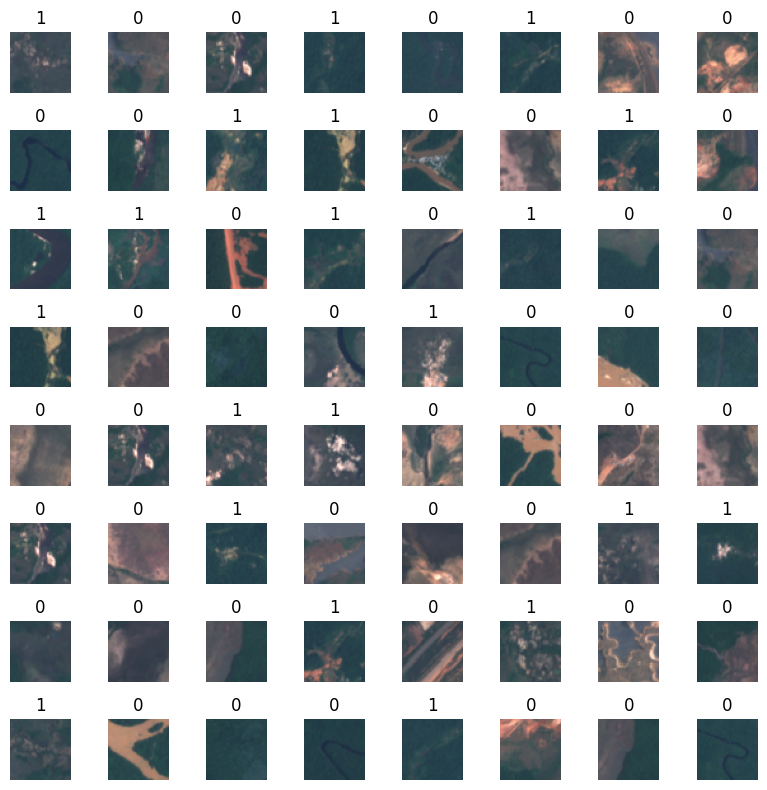

In [5]:
num_samples = 64
indices = np.random.randint(0, len(patches), num_samples)
viz_tools.plot_image_grid(patches[indices], labels=[int(label) for label in labels[indices]])

In [6]:
def filter_black(data, mask_limit=0.1, return_rejects=False):
    masked_fraction = np.array([np.sum(np.mean(patch, axis=-1) < 10) / np.size(np.mean(patch, axis=-1)) for patch in data])
    filtered_data = data[masked_fraction < mask_limit]
    print(f"{len(filtered_data) / len(data) :.1%} of data below brightness limit")
    if return_rejects:
        rejected_data = data[masked_fraction >= mask_limit]
        return filtered_data, rejected_data
    else:
        return filtered_data

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.422].


100.0% of data below brightness limit


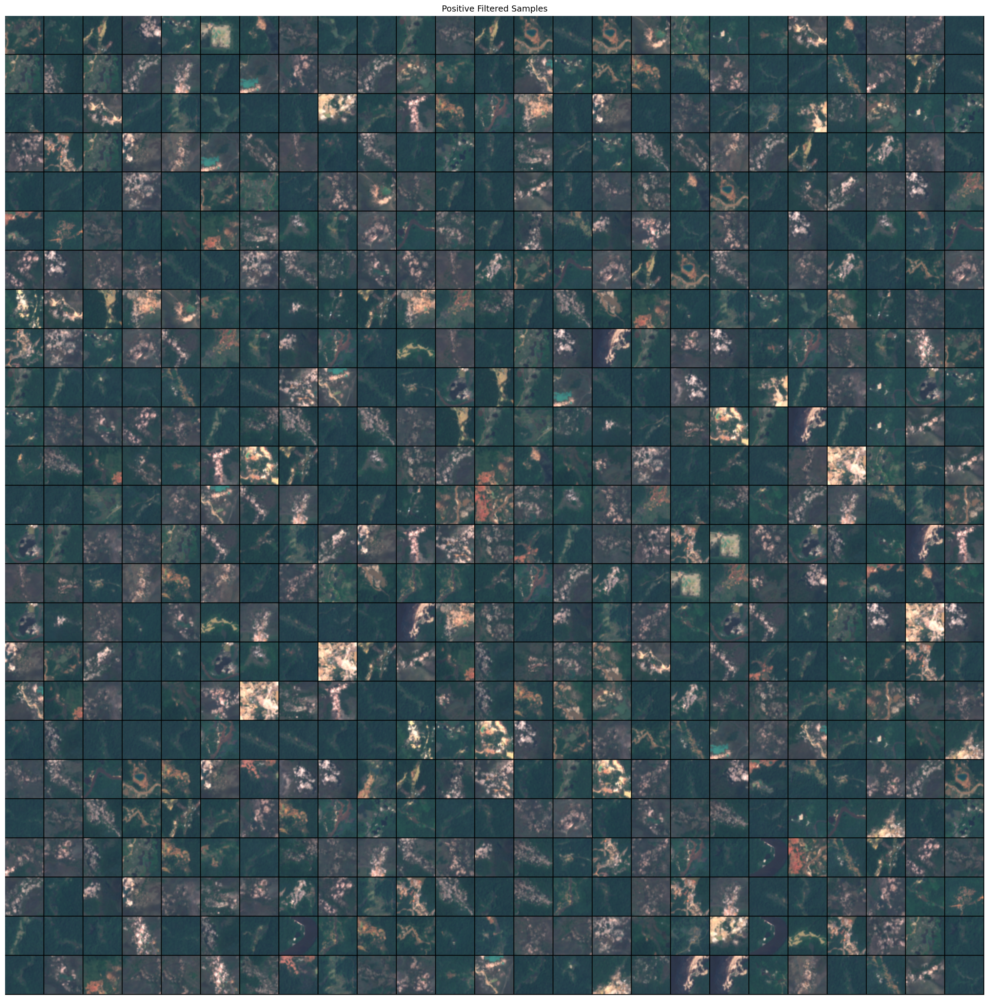

In [7]:
# Filter positive pixels that are masked beyond a threshold. Don't want to give positive examples of cloud-masked patches
filtered_positives, positive_rejects = filter_black(positive_patches, mask_limit = 0.1, return_rejects=True)
if len(positive_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(positive_rejects), num_samples)
    viz_tools.plot_numpy_grid(positive_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Positive Masked Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_positives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_positives[indices,:,:,3:0:-1] / 3000)
plt.title('Positive Filtered Samples')
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.5443333333333333].


100.0% of data below brightness limit


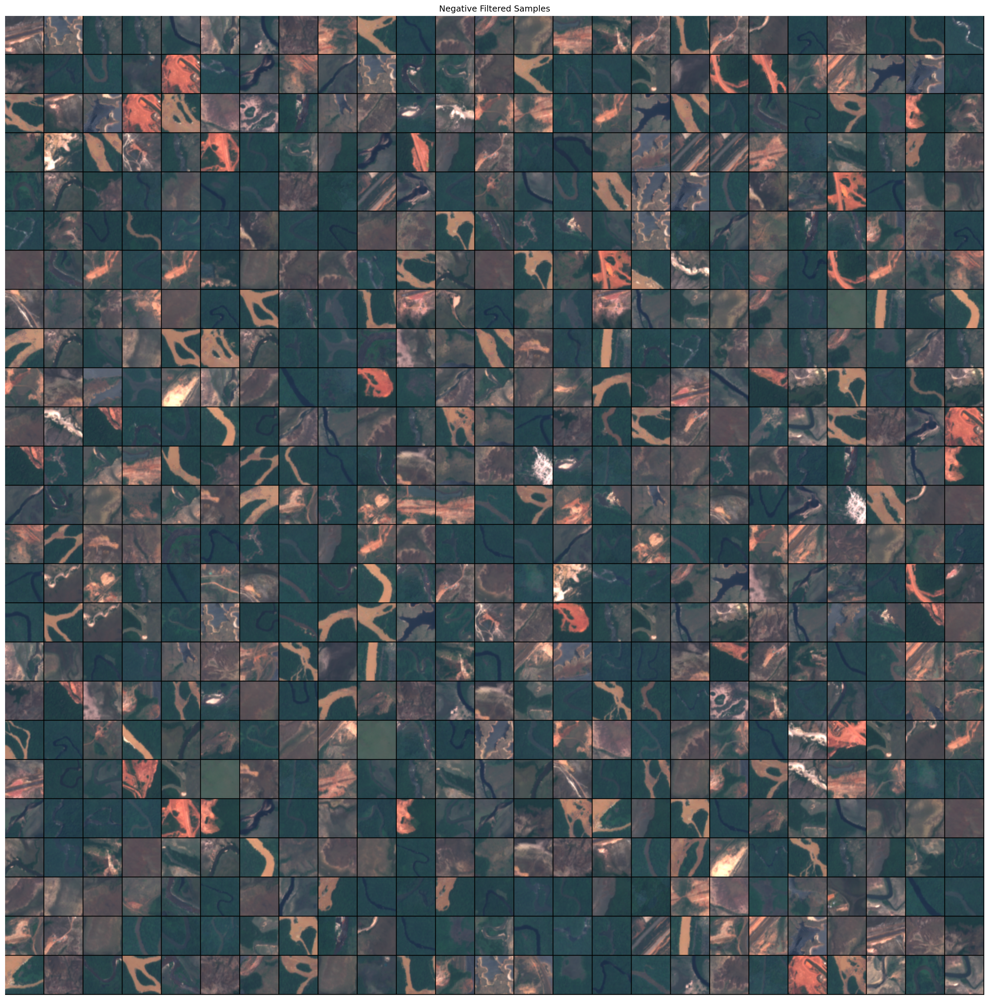

In [8]:
filtered_negatives, negative_rejects = filter_black(negative_patches, mask_limit = 0.6, return_rejects=True)
if len(negative_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(negative_rejects), num_samples)
    viz_tools.plot_numpy_grid(negative_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Negative Mask Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_negatives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_negatives[indices,:,:,3:0:-1] / 3000)
plt.title('Negative Filtered Samples')
plt.show()

## Prepare Data for Training

In [9]:
#for RGBIR, x = normalize(np.copy(images[:,:,:,[1,2,3,8]]))
x = np.concatenate((filtered_negatives, filtered_positives))
y = np.concatenate((np.zeros(len(filtered_negatives)), np.ones(len(filtered_positives))))
x, y = shuffle(x, y, random_state=33)

## Data Augmentation
Augmentation is important to help the model train. These are parameters that generally worked, but there is certainly room for improvement.

Plot a set of images to give an example of augmented images

/Users/selmadissing/miniforge3/envs/mining-detector/lib/python3.9/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (502, 48, 48, 12) (12 channels).
  warnings.warn(


  0%|          | 0/64 [00:00<?, ?it/s]

<Figure size 1800x1800 with 0 Axes>

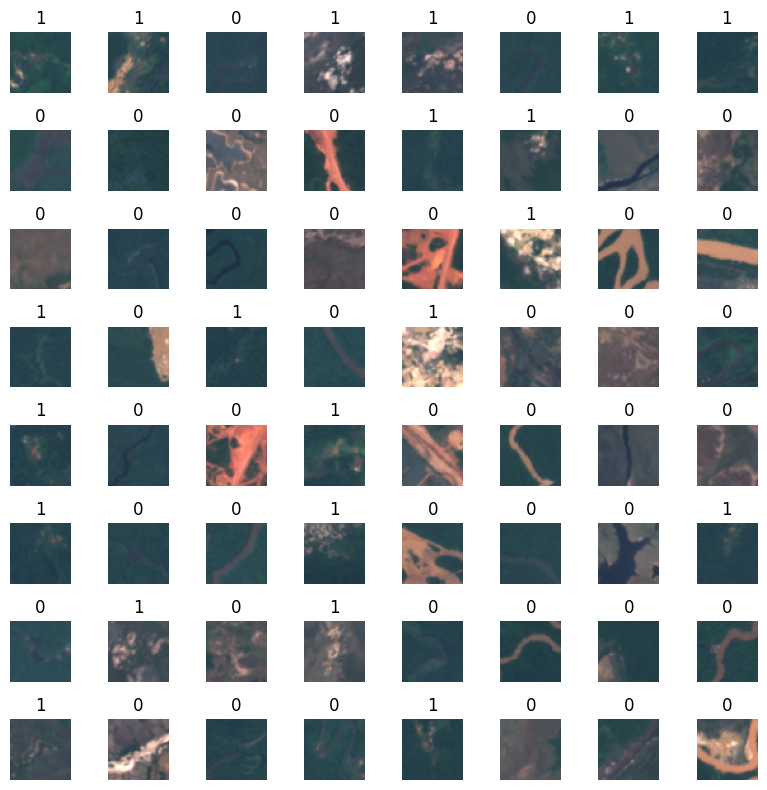

In [10]:
augmentation_parameters = {
    'featurewise_center': False,
    'rotation_range': 360,
    'width_shift_range': [0.9, 1.1],
    'height_shift_range': [0.9, 1.1],
    'shear_range': 10,
    'zoom_range': [0.9, 1.1],
    'vertical_flip': True,
    'horizontal_flip': True,
    # Fill options: "constant", "nearest", "reflect" or "wrap"
    'fill_mode': 'reflect'
}

datagen = ImageDataGenerator(**augmentation_parameters)


plt.figure(figsize=(12,12), facecolor=(1,1,1), dpi=150)
aug_img, aug_labels = datagen.flow(x, y, batch_size=64).next()
viz_tools.plot_image_grid(aug_img, labels=[int(l) for l in aug_labels], norm=True);


In [11]:
x_norm = np.clip(np.array(x.astype("float32") / 10000), 0, 1)

## Train Ensemble

Min Value:		 0.006
Max Value:		 0.661
Median Value:		 0.126
Num Train:		 351
Num Test:		 151
Percent Negative Train:	 64.7
Percent Negative Test:	 69.5
Input Shape: (48, 48, 12)
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 48, 48, 32)        3488      
                                                                 
 conv2d_1 (Conv2D)           (None, 48, 48, 32)        9248      
                                                                 
 conv2d_2 (Conv2D)           (None, 48, 48, 32)        9248      
                                                                 
 max_pooling2d (MaxPooling2  (None, 24, 24, 32)        0         
 D)                                                              
                                                                 
 conv2d_3 (Conv2D)           (None, 24, 24, 32)        9248      
          

/Users/selmadissing/miniforge3/envs/mining-detector/lib/python3.9/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (351, 48, 48, 12) (12 channels).
  warnings.warn(


Epoch 1/160
11/11 [==============================] - 6s 340ms/step - loss: 0.6907 - acc: 0.6382 - val_loss: 0.6801 - val_acc: 0.6954
Epoch 2/160
11/11 [==============================] - 3s 305ms/step - loss: 0.6647 - acc: 0.6467 - val_loss: 0.6219 - val_acc: 0.6954
Epoch 3/160
11/11 [==============================] - 3s 234ms/step - loss: 0.6588 - acc: 0.6467 - val_loss: 0.6355 - val_acc: 0.6954
Epoch 4/160
11/11 [==============================] - 3s 326ms/step - loss: 0.6386 - acc: 0.6496 - val_loss: 0.6057 - val_acc: 0.6954
Epoch 5/160
11/11 [==============================] - 6s 582ms/step - loss: 0.6374 - acc: 0.6439 - val_loss: 0.6051 - val_acc: 0.6954
Epoch 6/160
11/11 [==============================] - 5s 451ms/step - loss: 0.6052 - acc: 0.6467 - val_loss: 0.5603 - val_acc: 0.6954
Epoch 7/160
11/11 [==============================] - 3s 244ms/step - loss: 0.5803 - acc: 0.6467 - val_loss: 0.5052 - val_acc: 0.6954
Epoch 8/160
11/11 [==============================] - 3s 224ms/step - 

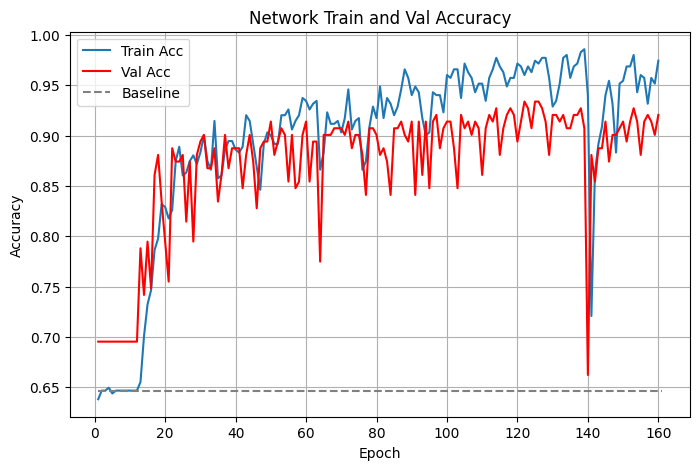

Test Set Metrics:
5/5 [==============================] - 0s 38ms/step
              precision    recall  f1-score   support

     No Mine       0.93      0.97      0.95       105
        Mine       0.93      0.83      0.87        46

    accuracy                           0.93       151
   macro avg       0.93      0.90      0.91       151
weighted avg       0.93      0.93      0.93       151

5/5 [==============================] - 0s 43ms/step


/Users/selmadissing/miniforge3/envs/mining-detector/lib/python3.9/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Min Value:		 0.006
Max Value:		 0.586
Median Value:		 0.126
Num Train:		 351
Num Test:		 151
Percent Negative Train:	 68.4
Percent Negative Test:	 60.9
Input Shape: (48, 48, 12)
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_9 (Conv2D)           (None, 48, 48, 32)        3488      
                                                                 
 conv2d_10 (Conv2D)          (None, 48, 48, 32)        9248      
                                                                 
 conv2d_11 (Conv2D)          (None, 48, 48, 32)        9248      
                                                                 
 max_pooling2d_3 (MaxPoolin  (None, 24, 24, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_12 (Conv2D)          (None, 24, 24, 32)        9248      
        

Epoch 1/160


/Users/selmadissing/miniforge3/envs/mining-detector/lib/python3.9/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (351, 48, 48, 12) (12 channels).
  warnings.warn(


11/11 [==============================] - 5s 269ms/step - loss: 0.6900 - acc: 0.6553 - val_loss: 0.6861 - val_acc: 0.6093
Epoch 2/160
11/11 [==============================] - 3s 257ms/step - loss: 0.6604 - acc: 0.6695 - val_loss: 0.6914 - val_acc: 0.6093
Epoch 3/160
11/11 [==============================] - 3s 240ms/step - loss: 0.6533 - acc: 0.6724 - val_loss: 0.6676 - val_acc: 0.6093
Epoch 4/160
11/11 [==============================] - 3s 268ms/step - loss: 0.6409 - acc: 0.6781 - val_loss: 0.6710 - val_acc: 0.6093
Epoch 5/160
11/11 [==============================] - 3s 264ms/step - loss: 0.6264 - acc: 0.6838 - val_loss: 0.6560 - val_acc: 0.6093
Epoch 6/160
11/11 [==============================] - 2s 219ms/step - loss: 0.6145 - acc: 0.6752 - val_loss: 0.6494 - val_acc: 0.6093
Epoch 7/160
11/11 [==============================] - 3s 227ms/step - loss: 0.6164 - acc: 0.6838 - val_loss: 0.6286 - val_acc: 0.6093
Epoch 8/160
11/11 [==============================] - 3s 250ms/step - loss: 0.5968

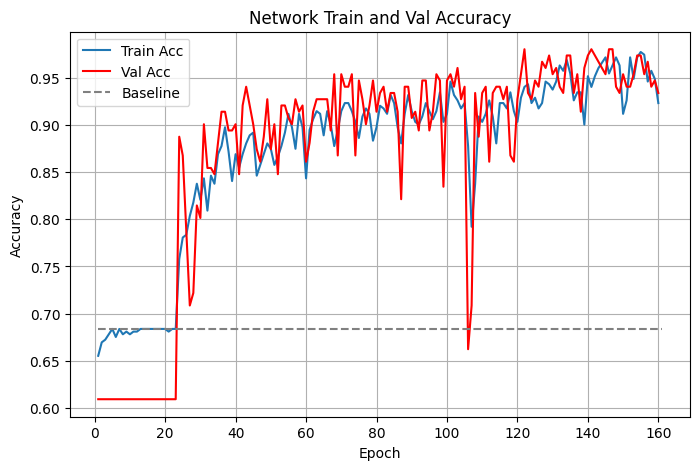

Test Set Metrics:
5/5 [==============================] - 0s 21ms/step
              precision    recall  f1-score   support

     No Mine       0.78      0.98      0.87        92
        Mine       0.94      0.58      0.72        59

    accuracy                           0.82       151
   macro avg       0.86      0.78      0.79       151
weighted avg       0.85      0.82      0.81       151

5/5 [==============================] - 0s 22ms/step


/Users/selmadissing/miniforge3/envs/mining-detector/lib/python3.9/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Min Value:		 0.006
Max Value:		 0.586
Median Value:		 0.126
Num Train:		 351
Num Test:		 151
Percent Negative Train:	 65.0
Percent Negative Test:	 68.9
Input Shape: (48, 48, 12)
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_18 (Conv2D)          (None, 48, 48, 32)        3488      
                                                                 
 conv2d_19 (Conv2D)          (None, 48, 48, 32)        9248      
                                                                 
 conv2d_20 (Conv2D)          (None, 48, 48, 32)        9248      
                                                                 
 max_pooling2d_6 (MaxPoolin  (None, 24, 24, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_21 (Conv2D)          (None, 24, 24, 32)        9248      
        

Epoch 1/160


/Users/selmadissing/miniforge3/envs/mining-detector/lib/python3.9/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (351, 48, 48, 12) (12 channels).
  warnings.warn(


11/11 [==============================] - 2s 116ms/step - loss: 0.6834 - acc: 0.6382 - val_loss: 0.6522 - val_acc: 0.6887
Epoch 2/160
11/11 [==============================] - 1s 108ms/step - loss: 0.6728 - acc: 0.6496 - val_loss: 0.6219 - val_acc: 0.6887
Epoch 3/160
11/11 [==============================] - 1s 105ms/step - loss: 0.6680 - acc: 0.6382 - val_loss: 0.6520 - val_acc: 0.6887
Epoch 4/160
11/11 [==============================] - 1s 108ms/step - loss: 0.6549 - acc: 0.6496 - val_loss: 0.6099 - val_acc: 0.6887
Epoch 5/160
11/11 [==============================] - 1s 111ms/step - loss: 0.6562 - acc: 0.6467 - val_loss: 0.6129 - val_acc: 0.6887
Epoch 6/160
11/11 [==============================] - 1s 112ms/step - loss: 0.6376 - acc: 0.6553 - val_loss: 0.5887 - val_acc: 0.6887
Epoch 7/160
11/11 [==============================] - 1s 110ms/step - loss: 0.6614 - acc: 0.6496 - val_loss: 0.6306 - val_acc: 0.6887
Epoch 8/160
11/11 [==============================] - 1s 103ms/step - loss: 0.6509

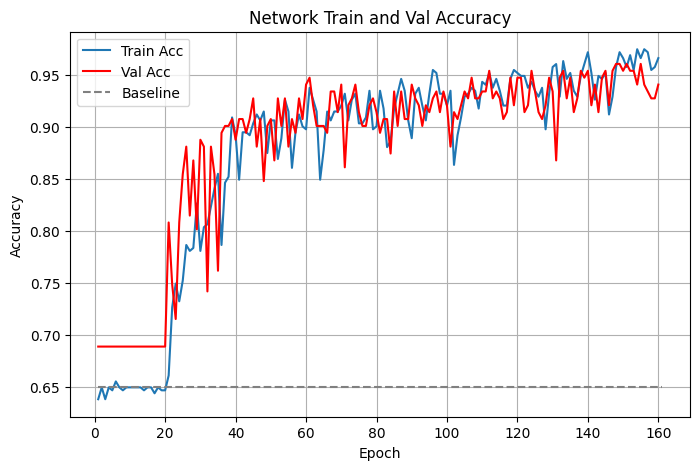

Test Set Metrics:
5/5 [==============================] - 0s 26ms/step
              precision    recall  f1-score   support

     No Mine       0.91      1.00      0.95       104
        Mine       1.00      0.79      0.88        47

    accuracy                           0.93       151
   macro avg       0.96      0.89      0.92       151
weighted avg       0.94      0.93      0.93       151

5/5 [==============================] - 0s 27ms/step
Min Value:		 0.006
Max Value:		 0.661


/Users/selmadissing/miniforge3/envs/mining-detector/lib/python3.9/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Median Value:		 0.126
Num Train:		 351
Num Test:		 151
Percent Negative Train:	 67.2
Percent Negative Test:	 63.6
Input Shape: (48, 48, 12)
Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_27 (Conv2D)          (None, 48, 48, 32)        3488      
                                                                 
 conv2d_28 (Conv2D)          (None, 48, 48, 32)        9248      
                                                                 
 conv2d_29 (Conv2D)          (None, 48, 48, 32)        9248      
                                                                 
 max_pooling2d_9 (MaxPoolin  (None, 24, 24, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_30 (Conv2D)          (None, 24, 24, 32)        9248      
                                              

Epoch 1/160


/Users/selmadissing/miniforge3/envs/mining-detector/lib/python3.9/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (351, 48, 48, 12) (12 channels).
  warnings.warn(


11/11 [==============================] - 4s 155ms/step - loss: 0.6798 - acc: 0.6610 - val_loss: 0.6583 - val_acc: 0.6358
Epoch 2/160
11/11 [==============================] - 2s 146ms/step - loss: 0.6512 - acc: 0.6752 - val_loss: 0.6532 - val_acc: 0.6358
Epoch 3/160
11/11 [==============================] - 2s 146ms/step - loss: 0.6301 - acc: 0.6724 - val_loss: 0.6493 - val_acc: 0.6358
Epoch 4/160
11/11 [==============================] - 2s 133ms/step - loss: 0.6474 - acc: 0.6724 - val_loss: 0.6407 - val_acc: 0.6358
Epoch 5/160
11/11 [==============================] - 1s 125ms/step - loss: 0.6413 - acc: 0.6724 - val_loss: 0.6266 - val_acc: 0.6358
Epoch 6/160
11/11 [==============================] - 1s 127ms/step - loss: 0.6219 - acc: 0.6724 - val_loss: 0.6326 - val_acc: 0.6358
Epoch 7/160
11/11 [==============================] - 2s 168ms/step - loss: 0.6293 - acc: 0.6724 - val_loss: 0.6054 - val_acc: 0.6358
Epoch 8/160
11/11 [==============================] - 2s 152ms/step - loss: 0.6032

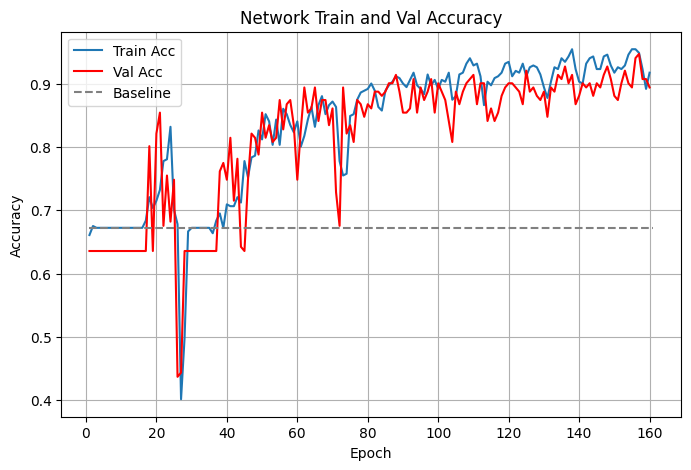

Test Set Metrics:
5/5 [==============================] - 0s 24ms/step
              precision    recall  f1-score   support

     No Mine       0.84      0.97      0.90        96
        Mine       0.93      0.67      0.78        55

    accuracy                           0.86       151
   macro avg       0.88      0.82      0.84       151
weighted avg       0.87      0.86      0.85       151

5/5 [==============================] - 0s 23ms/step
Min Value:		 0.006
Max Value:		 0.571


/Users/selmadissing/miniforge3/envs/mining-detector/lib/python3.9/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Median Value:		 0.126
Num Train:		 351
Num Test:		 151
Percent Negative Train:	 67.2
Percent Negative Test:	 63.6
Input Shape: (48, 48, 12)
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_36 (Conv2D)          (None, 48, 48, 32)        3488      
                                                                 
 conv2d_37 (Conv2D)          (None, 48, 48, 32)        9248      
                                                                 
 conv2d_38 (Conv2D)          (None, 48, 48, 32)        9248      
                                                                 
 max_pooling2d_12 (MaxPooli  (None, 24, 24, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_39 (Conv2D)          (None, 24, 24, 32)        9248      
                                              

Epoch 1/160


/Users/selmadissing/miniforge3/envs/mining-detector/lib/python3.9/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (351, 48, 48, 12) (12 channels).
  warnings.warn(


11/11 [==============================] - 2s 123ms/step - loss: 0.6827 - acc: 0.6467 - val_loss: 0.6634 - val_acc: 0.6358
Epoch 2/160
11/11 [==============================] - 1s 114ms/step - loss: 0.6532 - acc: 0.6752 - val_loss: 0.6552 - val_acc: 0.6358
Epoch 3/160
11/11 [==============================] - 1s 108ms/step - loss: 0.6539 - acc: 0.6724 - val_loss: 0.6572 - val_acc: 0.6358
Epoch 4/160
11/11 [==============================] - 1s 114ms/step - loss: 0.6532 - acc: 0.6638 - val_loss: 0.6539 - val_acc: 0.6358
Epoch 5/160
11/11 [==============================] - 1s 109ms/step - loss: 0.6464 - acc: 0.6667 - val_loss: 0.6471 - val_acc: 0.6358
Epoch 6/160
11/11 [==============================] - 1s 108ms/step - loss: 0.6272 - acc: 0.6667 - val_loss: 0.6372 - val_acc: 0.6358
Epoch 7/160
11/11 [==============================] - 2s 138ms/step - loss: 0.6309 - acc: 0.6724 - val_loss: 0.6349 - val_acc: 0.6358
Epoch 8/160
11/11 [==============================] - 1s 113ms/step - loss: 0.6019

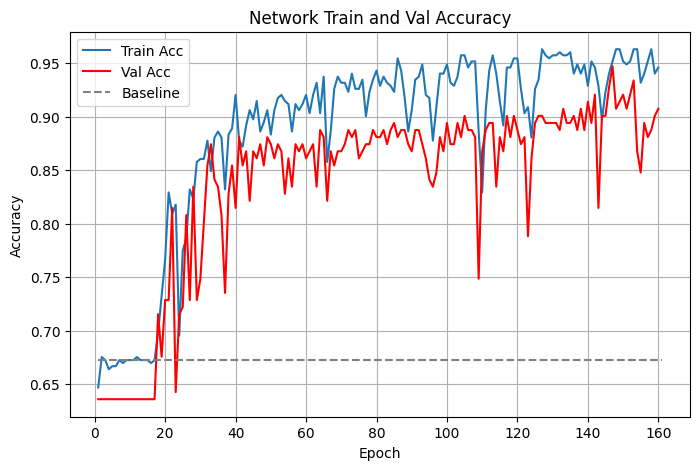

Test Set Metrics:
5/5 [==============================] - 0s 23ms/step
              precision    recall  f1-score   support

     No Mine       0.89      0.93      0.91        96
        Mine       0.86      0.80      0.83        55

    accuracy                           0.88       151
   macro avg       0.88      0.86      0.87       151
weighted avg       0.88      0.88      0.88       151

5/5 [==============================] - 0s 24ms/step
Min Value:		 0.006
Max Value:		 0.661


/Users/selmadissing/miniforge3/envs/mining-detector/lib/python3.9/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Median Value:		 0.126
Num Train:		 351
Num Test:		 151
Percent Negative Train:	 64.1
Percent Negative Test:	 70.9
Input Shape: (48, 48, 12)
Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_45 (Conv2D)          (None, 48, 48, 32)        3488      
                                                                 
 conv2d_46 (Conv2D)          (None, 48, 48, 32)        9248      
                                                                 
 conv2d_47 (Conv2D)          (None, 48, 48, 32)        9248      
                                                                 
 max_pooling2d_15 (MaxPooli  (None, 24, 24, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_48 (Conv2D)          (None, 24, 24, 32)        9248      
                                              

Epoch 1/160


/Users/selmadissing/miniforge3/envs/mining-detector/lib/python3.9/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (351, 48, 48, 12) (12 channels).
  warnings.warn(


11/11 [==============================] - 2s 134ms/step - loss: 0.6912 - acc: 0.6068 - val_loss: 0.6845 - val_acc: 0.7086
Epoch 2/160
11/11 [==============================] - 1s 112ms/step - loss: 0.6858 - acc: 0.6097 - val_loss: 0.6448 - val_acc: 0.7086
Epoch 3/160
11/11 [==============================] - 1s 114ms/step - loss: 0.6712 - acc: 0.6325 - val_loss: 0.6326 - val_acc: 0.7086
Epoch 4/160
11/11 [==============================] - 1s 110ms/step - loss: 0.6582 - acc: 0.6211 - val_loss: 0.5985 - val_acc: 0.7086
Epoch 5/160
11/11 [==============================] - 1s 113ms/step - loss: 0.6581 - acc: 0.6353 - val_loss: 0.6021 - val_acc: 0.7086
Epoch 6/160
11/11 [==============================] - 1s 115ms/step - loss: 0.6393 - acc: 0.6296 - val_loss: 0.5802 - val_acc: 0.7086
Epoch 7/160
11/11 [==============================] - 1s 111ms/step - loss: 0.6146 - acc: 0.6382 - val_loss: 0.5183 - val_acc: 0.7086
Epoch 8/160
11/11 [==============================] - 1s 115ms/step - loss: 0.5673

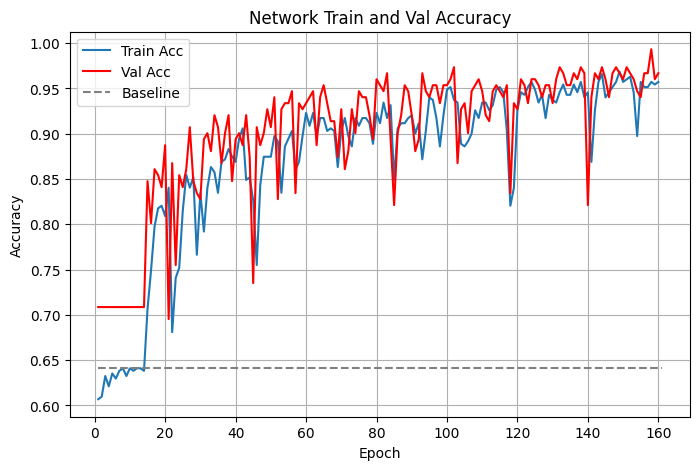

Test Set Metrics:
5/5 [==============================] - 0s 23ms/step
              precision    recall  f1-score   support

     No Mine       0.96      0.99      0.98       107
        Mine       0.98      0.91      0.94        44

    accuracy                           0.97       151
   macro avg       0.97      0.95      0.96       151
weighted avg       0.97      0.97      0.97       151

5/5 [==============================] - 0s 24ms/step
Min Value:		 0.006
Max Value:		 0.586
Median Value:		 0.125
Num Train:		 351
Num Test:		 151
Percent Negative Train:	 66.4
Percent Negative Test:	 65.6
Input Shape: (48, 48, 12)


/Users/selmadissing/miniforge3/envs/mining-detector/lib/python3.9/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_54 (Conv2D)          (None, 48, 48, 32)        3488      
                                                                 
 conv2d_55 (Conv2D)          (None, 48, 48, 32)        9248      
                                                                 
 conv2d_56 (Conv2D)          (None, 48, 48, 32)        9248      
                                                                 
 max_pooling2d_18 (MaxPooli  (None, 24, 24, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_57 (Conv2D)          (None, 24, 24, 32)        9248      
                                                                 
 conv2d_58 (Conv2D)          (None, 24, 24, 32)        9248      
                                                      

Epoch 1/160


/Users/selmadissing/miniforge3/envs/mining-detector/lib/python3.9/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (351, 48, 48, 12) (12 channels).
  warnings.warn(


11/11 [==============================] - 2s 134ms/step - loss: 0.6743 - acc: 0.6467 - val_loss: 0.6493 - val_acc: 0.6556
Epoch 2/160
11/11 [==============================] - 1s 111ms/step - loss: 0.6441 - acc: 0.6638 - val_loss: 0.6444 - val_acc: 0.6556
Epoch 3/160
11/11 [==============================] - 1s 118ms/step - loss: 0.6534 - acc: 0.6638 - val_loss: 0.6400 - val_acc: 0.6556
Epoch 4/160
11/11 [==============================] - 1s 111ms/step - loss: 0.6496 - acc: 0.6638 - val_loss: 0.6372 - val_acc: 0.6556
Epoch 5/160
11/11 [==============================] - 1s 113ms/step - loss: 0.6424 - acc: 0.6610 - val_loss: 0.6336 - val_acc: 0.6556
Epoch 6/160
11/11 [==============================] - 1s 110ms/step - loss: 0.6266 - acc: 0.6638 - val_loss: 0.6126 - val_acc: 0.6556
Epoch 7/160
11/11 [==============================] - 1s 111ms/step - loss: 0.5871 - acc: 0.6638 - val_loss: 0.5826 - val_acc: 0.6556
Epoch 8/160
11/11 [==============================] - 1s 116ms/step - loss: 0.5562

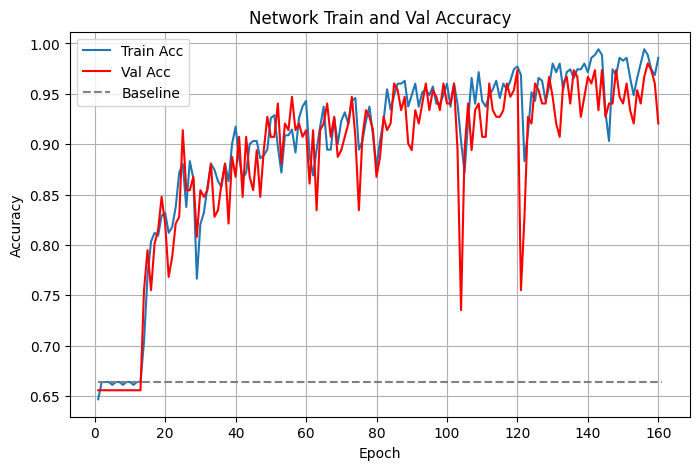

Test Set Metrics:
5/5 [==============================] - 0s 25ms/step
              precision    recall  f1-score   support

     No Mine       0.86      0.99      0.92        99
        Mine       0.97      0.69      0.81        52

    accuracy                           0.89       151
   macro avg       0.92      0.84      0.86       151
weighted avg       0.90      0.89      0.88       151

5/5 [==============================] - 0s 24ms/step
Min Value:		 0.006
Max Value:		 0.571
Median Value:		 0.125
Num Train:		 351
Num Test:		 151
Percent Negative Train:	 66.4
Percent Negative Test:	 65.6
Input Shape: (48, 48, 12)


/Users/selmadissing/miniforge3/envs/mining-detector/lib/python3.9/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_63 (Conv2D)          (None, 48, 48, 32)        3488      
                                                                 
 conv2d_64 (Conv2D)          (None, 48, 48, 32)        9248      
                                                                 
 conv2d_65 (Conv2D)          (None, 48, 48, 32)        9248      
                                                                 
 max_pooling2d_21 (MaxPooli  (None, 24, 24, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_66 (Conv2D)          (None, 24, 24, 32)        9248      
                                                                 
 conv2d_67 (Conv2D)          (None, 24, 24, 32)        9248      
                                                      

Epoch 1/160


/Users/selmadissing/miniforge3/envs/mining-detector/lib/python3.9/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (351, 48, 48, 12) (12 channels).
  warnings.warn(


11/11 [==============================] - 2s 115ms/step - loss: 0.6888 - acc: 0.6040 - val_loss: 0.6692 - val_acc: 0.6556
Epoch 2/160
11/11 [==============================] - 1s 113ms/step - loss: 0.6620 - acc: 0.6553 - val_loss: 0.6465 - val_acc: 0.6556
Epoch 3/160
11/11 [==============================] - 1s 100ms/step - loss: 0.6592 - acc: 0.6496 - val_loss: 0.6431 - val_acc: 0.6556
Epoch 4/160
11/11 [==============================] - 1s 127ms/step - loss: 0.6443 - acc: 0.6695 - val_loss: 0.6344 - val_acc: 0.6556
Epoch 5/160
11/11 [==============================] - 2s 150ms/step - loss: 0.6440 - acc: 0.6524 - val_loss: 0.6288 - val_acc: 0.6556
Epoch 6/160
11/11 [==============================] - 2s 143ms/step - loss: 0.6480 - acc: 0.6581 - val_loss: 0.6107 - val_acc: 0.6556
Epoch 7/160
11/11 [==============================] - 1s 120ms/step - loss: 0.6148 - acc: 0.6610 - val_loss: 0.5993 - val_acc: 0.6556
Epoch 8/160
11/11 [==============================] - 1s 102ms/step - loss: 0.6045

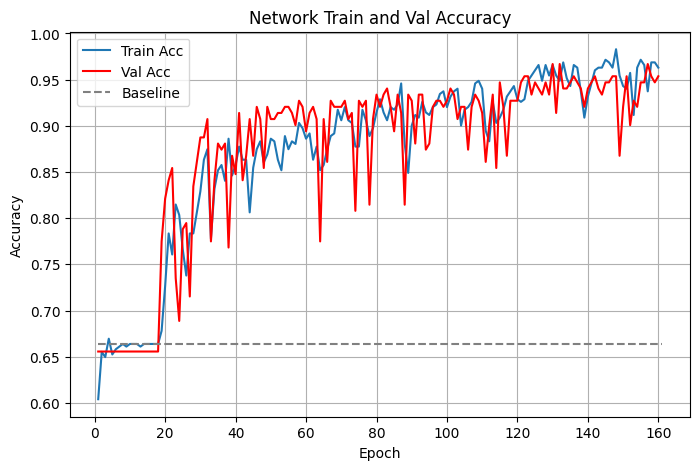

Test Set Metrics:
5/5 [==============================] - 0s 23ms/step
              precision    recall  f1-score   support

     No Mine       0.95      0.95      0.95        99
        Mine       0.90      0.90      0.90        52

    accuracy                           0.93       151
   macro avg       0.93      0.93      0.93       151
weighted avg       0.93      0.93      0.93       151

5/5 [==============================] - 0s 25ms/step


/Users/selmadissing/miniforge3/envs/mining-detector/lib/python3.9/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Min Value:		 0.006
Max Value:		 0.661
Median Value:		 0.126
Num Train:		 351
Num Test:		 151
Percent Negative Train:	 67.0
Percent Negative Test:	 64.2
Input Shape: (48, 48, 12)
Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_72 (Conv2D)          (None, 48, 48, 32)        3488      
                                                                 
 conv2d_73 (Conv2D)          (None, 48, 48, 32)        9248      
                                                                 
 conv2d_74 (Conv2D)          (None, 48, 48, 32)        9248      
                                                                 
 max_pooling2d_24 (MaxPooli  (None, 24, 24, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_75 (Conv2D)          (None, 24, 24, 32)        9248      
        

Epoch 1/160


/Users/selmadissing/miniforge3/envs/mining-detector/lib/python3.9/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (351, 48, 48, 12) (12 channels).
  warnings.warn(


11/11 [==============================] - 4s 159ms/step - loss: 0.6849 - acc: 0.6467 - val_loss: 0.6668 - val_acc: 0.6424
Epoch 2/160
11/11 [==============================] - 1s 122ms/step - loss: 0.6532 - acc: 0.6667 - val_loss: 0.6559 - val_acc: 0.6424
Epoch 3/160
11/11 [==============================] - 2s 128ms/step - loss: 0.6447 - acc: 0.6695 - val_loss: 0.6532 - val_acc: 0.6424
Epoch 4/160
11/11 [==============================] - 1s 108ms/step - loss: 0.6597 - acc: 0.6695 - val_loss: 0.6510 - val_acc: 0.6424
Epoch 5/160
11/11 [==============================] - 1s 107ms/step - loss: 0.6523 - acc: 0.6638 - val_loss: 0.6438 - val_acc: 0.6424
Epoch 6/160
11/11 [==============================] - 1s 110ms/step - loss: 0.6257 - acc: 0.6695 - val_loss: 0.6318 - val_acc: 0.6424
Epoch 7/160
11/11 [==============================] - 1s 114ms/step - loss: 0.6230 - acc: 0.6667 - val_loss: 0.6134 - val_acc: 0.6424
Epoch 8/160
11/11 [==============================] - 2s 141ms/step - loss: 0.6122

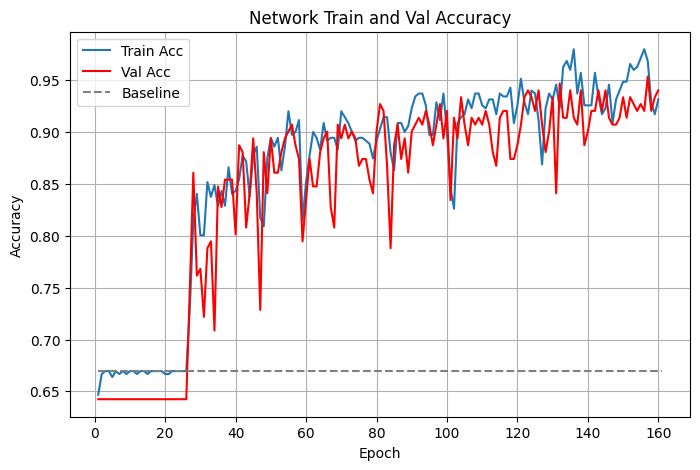

Test Set Metrics:
5/5 [==============================] - 0s 30ms/step
              precision    recall  f1-score   support

     No Mine       0.97      0.93      0.95        97
        Mine       0.88      0.94      0.91        54

    accuracy                           0.93       151
   macro avg       0.92      0.94      0.93       151
weighted avg       0.94      0.93      0.93       151

5/5 [==============================] - 0s 31ms/step


/Users/selmadissing/miniforge3/envs/mining-detector/lib/python3.9/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [12]:

for seed, name in zip([1, 2, 3, 4, 5, 6, 7, 8, 9], ['a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i']):
        keras.utils.set_random_seed(seed)
        x_train, x_test, y_train, y_test = train_test_split(x_norm, y, test_size=0.30, random_state=seed)
        print(f"Min Value:\t\t {np.min(x_train):.3f}")
        print(f"Max Value:\t\t {np.max(x_train):.3f}")
        print(f"Median Value:\t\t {np.median(x_train):.3f}")
        print("Num Train:\t\t", len(x_train))
        print("Num Test:\t\t", len(x_test))
        print(f"Percent Negative Train:\t {100 * sum(y_train == 0.0) / len(y_train):.1f}")
        print(f"Percent Negative Test:\t {100 * sum(y_test == 0.0) / len(y_test):.1f}")

        num_classes = 2
        input_shape = x_train.shape[1:]
        print("Input Shape:", input_shape)

        model = keras.Sequential([
                keras.Input(shape=input_shape),
                layers.Conv2D(32, kernel_size=(3), padding='same', activation="relu"),
                layers.Conv2D(32, kernel_size=(3), padding='same', activation="relu"),
                layers.Conv2D(32, kernel_size=(3), padding='same', activation="relu"),
                layers.MaxPooling2D(pool_size=(2)),
                layers.Conv2D(32, kernel_size=(3), padding='same', activation="relu"),
                layers.Conv2D(32, kernel_size=(3), padding='same', activation="relu"),
                layers.Conv2D(32, kernel_size=(3), padding='same', activation="relu"),
                layers.MaxPooling2D(pool_size=(2)),
                layers.Conv2D(32, kernel_size=(3), padding='same', activation="relu"),
                layers.Conv2D(32, kernel_size=(3), padding='same', activation="relu"),
                layers.Conv2D(32, kernel_size=(3), padding='same', activation="relu"),
                layers.MaxPooling2D(pool_size=(3)),
                layers.Flatten(),
                layers.Dense(64, activation="relu"),
                layers.Dropout(0.3),
                layers.Dense(64, activation="relu"),
                layers.Dropout(0.3),
                layers.Dense(32, activation="relu"),
                layers.Dropout(0.3),
                layers.Dense(1, activation='sigmoid')])
        model.summary()
        model.compile(
        optimizer=keras.optimizers.Adam(3e-4), 
        loss=keras.losses.BinaryCrossentropy(from_logits=False), 
        metrics=[keras.metrics.BinaryAccuracy(name="acc")])

        train_accuracy = []
        test_accuracy = []

        batch_size = 32
        epochs = 160
        # add a weighted loss
        class_weight = {0: 1, 1: 1}

        model.fit(datagen.flow(x_train, y_train),
                batch_size=batch_size, 
                epochs=epochs, 
                validation_data = (x_test, y_test),
                verbose = 1,
                shuffle=True,
                class_weight = class_weight
                )
        train_accuracy += model.history.history['acc']
        test_accuracy += model.history.history['val_acc']


        plt.figure(figsize=(8,5), dpi=100, facecolor=(1,1,1))
        plt.plot([i for i in range(1, len(train_accuracy) + 1)], train_accuracy, label='Train Acc')
        plt.plot([i for i in range(1, len(train_accuracy) + 1)], test_accuracy, c='r', label='Val Acc')
        percent_negative = (sum(y_train == 0.0) / len(y_train))
        plt.plot([1, len(train_accuracy) + 1], [percent_negative, percent_negative], '--', c='gray', label='Baseline')
        plt.grid()
        plt.xlabel('Epoch')
        plt.ylabel('Accuracy')
        plt.legend()
        plt.title('Network Train and Val Accuracy')
        plt.show()

        threshold = 0.8
        print("Test Set Metrics:")
        preds = model.predict(x_test)
        print(classification_report(y_test, preds > threshold, 
                                target_names=['No Mine', 'Mine']))

        version_number = f'3.7-{name}'
        current_date = date.today()
        model_name = f"{resolution}px_v{version_number}_{current_date.isoformat()}"

        #assert not os.path.exists('../models/' + model_name + '.h5'), f"Model of name {model_name} already exists"

        with open('../models/' + model_name + '_config.txt', 'w') as f:
                f.write('Input Data:\n')
                [f.write('\t' + file + '\n') for file in data_files]
                f.write('\n\nAugmentation Parameters:\n')
                for k, v in zip(augmentation_parameters.keys(), augmentation_parameters.values()):
                        f.write(f"\t{k}: {v}\n")
                f.write(f"\nBatch Size: {batch_size}")
                f.write(f"\nTraining Epochs: {len(train_accuracy)}")
                f.write(f'\n\nClassification Report at {threshold}\n')
                f.write(classification_report(y_test, model.predict(x_test) > threshold, 
                                        target_names=['No Mine', 'Mine']))
                        

        model.save(f'../models/{model_name}.h5')

# Evaluate Model Performance Characteristics

Find the threshold that maximizes performance on the test set. Note that while this may be the optimum performance on the test set, it does not account for the fact that false positives are functionally worse than false negatives.

5/5 [==============================] - 0s 52ms/step


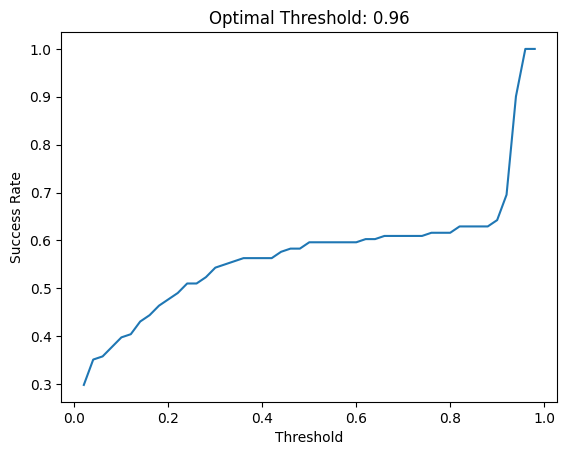

In [13]:
test_model = model

val_images = x_test
val_labels = y_test

test_preds = test_model.predict(val_images)
thresh = []
score = []
for threshold in range(2, 100, 2):
    threshold /= 100
    thresh.append(threshold)
    test_labels = [np.argmax(y) for y in val_labels]
    test_out = [pred > threshold for pred in test_preds]
    score.append(1 - (np.sum(np.array(test_labels) != np.array(test_out)[:,0]) / len(test_labels)))
    #print(np.sum(np.array(test_labels) != np.array(test_preds)), "of", len(test_labels), "test set predictions incorrect")
plt.plot(thresh, score)
plt.ylabel('Success Rate')
plt.xlabel('Threshold')
plt.title(f"Optimal Threshold: {thresh[np.argmax(score)]:.2f}")
plt.show()
optimal_threshold = thresh[np.argmax(score)]

Plot images that the model classifies incorrectly. Can be useful to evaluate model bias.

5/5 [==============================] - 0s 41ms/step


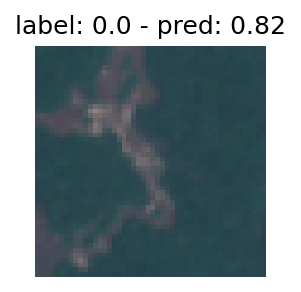

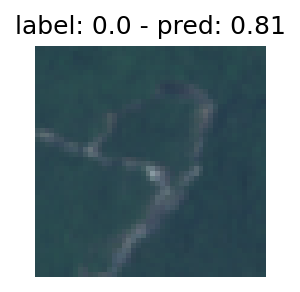

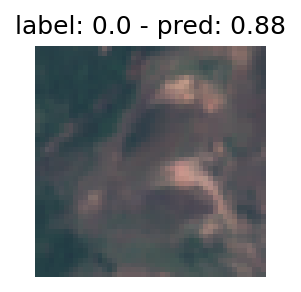

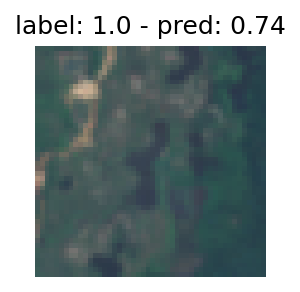

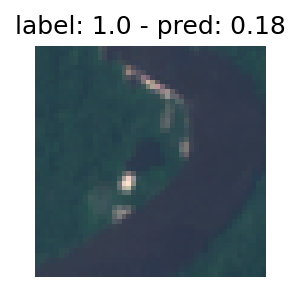

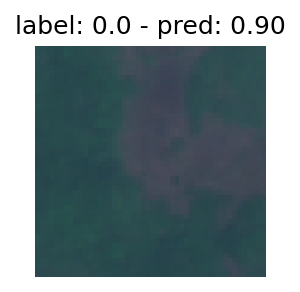

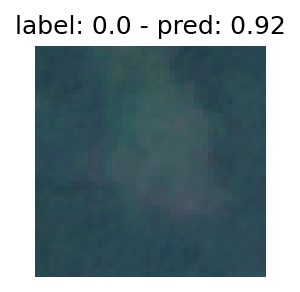

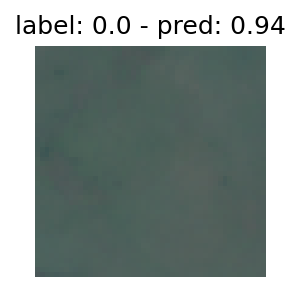

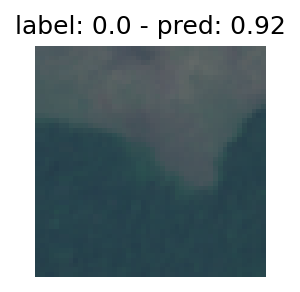

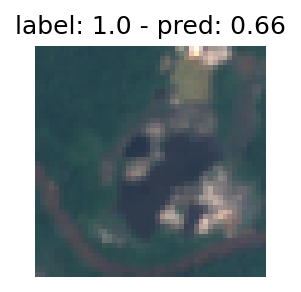

In [14]:
threshold = 0.8
test_model = model
val_images = x_test
val_labels = y_test
test_labels = val_labels
test_preds = test_model.predict(val_images)
for index, (label, pred, img) in enumerate(zip(test_labels, test_preds, val_images)):
    pred = pred[0]
    if pred < threshold:
        binary_pred = 0
    else:
        binary_pred = 1
    if label != binary_pred:
        rgb = (img[:,:,3:0:-1] * 10000 / 3000)
        fig = plt.figure(figsize=(2,2), facecolor=(1,1,1), dpi=150)
        plt.imshow(np.clip(rgb, 0, 1))
        plt.title(f"label: {label} - pred: {pred:.2f}")
        plt.axis('off')
        plt.show()